# Testing of Rs. 2000 currency notes

This notebook carries out the complete evaluation of an input Rs. 2000 currency note

In [38]:
# Importing all necessary libraries

import cv2                            # Importing Opencv library for image processing and computer vision
import numpy as np                    # Importing numpy library 
import matplotlib.pyplot as plt       # Importing matplotlib library to plot the images directly in notebook
from skimage.metrics import structural_similarity as ssim   # Importing ssim calculating modules from skimage library


#Resizing the Plots
plt.rcParams["figure.figsize"] = (12, 12)

In [39]:
path = r"C:\Users\galam\Desktop\FakeCurrency\Dataset\Fake Notes\2000\2000_f2.jpg"
print('Path of input image: ', path)

Path of input image:  C:\Users\galam\Desktop\FakeCurrency\Dataset\Fake Notes\2000\2000_f2.jpg


In [40]:
test_img = cv2.imread(path)

# Pre- processing

In [41]:
# Resizing the image
test_img = cv2.resize(test_img, (1165,455))

# Guassian Blur
blur_test_img = cv2.GaussianBlur(test_img, (5,5), 0)

# Grayscale conversion
gray_test_image = cv2.cvtColor(blur_test_img, cv2.COLOR_BGR2GRAY)

def preprocessing():
    # Showing original currency note
    plt.imshow(gray_test_image, 'gray')
    plt.title('Input image after pre- processing')
    plt.show()

In [42]:
#  Calculating SSIM of the two images sent as parameters

def calculateSSIM(template_img, query_img):
    
    min_w = min(template_img.shape[1], query_img.shape[1])
    min_h = min(template_img.shape[0], query_img.shape[0])
    
    # Resizing the two images so that both have same dimensions
    img1 = cv2.resize(template_img, (min_w, min_h))
    img2 = cv2.resize(query_img, (min_w, min_h))
    
    # Conversion to gray- scale
    img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
    img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)
    
    # Plotting the images
    plt.subplot(1, 2, 1)
    plt.imshow(img1, 'gray')
    
    plt.subplot(1, 2, 2)
    plt.imshow(img2, 'gray')
    
    plt.show()
    
    # Find the SSIM score and return
    score = ssim(img1, img2)
    return score

In [43]:
import cv2
import numpy as np

def computeORB(template_img, query_img):
    # ===================== Creating orb object ==============================
    nfeatures = 700
    scaleFactor = 1.2
    nlevels = 8
    edgeThreshold = 15  # Changed default (31)

    # Initialize the ORB detector algorithm 
    orb = cv2.ORB_create(
        nfeatures,
        scaleFactor,
        nlevels,
        edgeThreshold
    )
    # =========================================================================
    
    # Find the keypoints and descriptors with ORB
    kpts1, descs1 = orb.detectAndCompute(template_img, None)
    kpts2, descs2 = orb.detectAndCompute(query_img, None)
    
    # ====================================== Brute Force Matching ==============================
    bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)

    # Finding matches between the 2 descriptor sets
    matches = bf.match(descs1, descs2)

    # Sort the matches in the order of their distance (lower is better)
    dmatches = sorted(matches, key=lambda x: x.distance)

    # ============================================================================================
    
    # Check if we have enough matches (at least 4) for homography
    if len(dmatches) >= 4:
        # Extract the matched keypoints
        src_pts = np.float32([kpts1[m.queryIdx].pt for m in dmatches]).reshape(-1, 1, 2)
        dst_pts = np.float32([kpts2[m.trainIdx].pt for m in dmatches]).reshape(-1, 1, 2)

        # Compute homography using RANSAC
        M, mask = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 5.0)

        # Perform perspective transform if M is valid
        h, w = template_img.shape[:2]
        pts = np.float32([[0, 0], [0, h-1], [w-1, h-1], [w-1, 0]]).reshape(-1, 1, 2)

        if M is not None:
            dst = cv2.perspectiveTransform(pts, M)
        else:
            dst = None
    else:
        print(f"Not enough matches found: {len(dmatches)} matches.")
        dst = None
        dst_pts = None  # Ensure dst_pts is defined
        mask = None

    # Returning the results: dst_pts and kpts1, kpts2 should be defined whether homography succeeds or fails
    return dst, dst_pts, kpts1, kpts2, dmatches


# Features 1- 7: Using ORB and SSIM

In [44]:
# Values for specifying search area of features 1 to 7
search_area_list = [[200,270,160,330],
                    [1050,1500,250,400],
                    [50,400,0,100],
                    [750,1050,0,100],
                    [850,1050,280,380],
                    [700,820,290,370],
                    [400,650,0,100]]

# Values of max_area and min_area for each feature for features 1 to 7
feature_area_limits_list = [[10000,14000],
                            [9000,15000],
                            [17000,21500],
                            [19000,28000],
                            [17500,23000],
                            [6500,9000],
                            [10000,16000]]

score_set_list = []               # Stores the ssim score set of each feature
best_extracted_img_list = []      # Stores the extracted image with highest SSIM score for each feature
avg_ssim_list = []                # Stores the avg ssim value for each feature
NUM_OF_FEATURES = 7               # Number of features

In [45]:
# Algo- 1: Verification of features 1 to 7

def testFeature_1_2_7():
    i = 0
    j = 0
    NUMBER_OF_TEMPLATES = 6
    global score_set_list                # Stores the ssim score set of each feature
    global best_extracted_img_list       # Stores the extracted image with highest SSIM score for each feature
    global avg_ssim_list                 # Stores the avg ssim value for each feature


    # Iterating for each feature
    for j in range(NUM_OF_FEATURES):
        print('ANALYSIS OF FEATURE ' + str(j+1))

        score_set = []           # SSIM scores for each teamplate of current feature will be stored here
        max_score = -1           # Stores max SSIM score
        max_score_img = None     # Stores extraced image with max SSIM score for the current feature
        
        # Performing feature detection, extraction and comparison for each template stored in dataset 
        for i in range(NUMBER_OF_TEMPLATES):
            print('---> Template ' + str(i+1) + ' :')
            
            # Current template 
            template_path = r'Dataset\2000_Features Dataset\Feature ' + str(j+1) + '\\' + str(i+1) + '.jpg'
            template_img = cv2.imread(template_path)

            template_img_blur = cv2.GaussianBlur(template_img, (5,5), 0)
            template_img_gray = cv2.cvtColor(template_img_blur, cv2.COLOR_BGR2GRAY)
            test_img_mask = gray_test_image.copy()
            
            # Creating a mask to search the current template.
            search_area = search_area_list[j]

            test_img_mask[:, :search_area[0]] = 0
            test_img_mask[:, search_area[1]:] = 0
            test_img_mask[:search_area[2], :] = 0
            test_img_mask[search_area[3]:, :] = 0
            
            # Feature detection using ORB 
            dst, dst_pts, kpts1, kpts2, dmatches = computeORB(template_img_gray, test_img_mask)
            
            # Error handling
            if dst is None:
                print('An Error occurred - Homography matrix is of NoneType')
                continue
            
            query_img = test_img.copy()
            
            # drawing polygon around the region where the current template has been detected on the test currency note -- the blue polygon
            res_img1 = cv2.polylines(query_img, [np.int32(dst)], True, (0,0,255), 1, cv2.LINE_AA)

            # draw match lines between the matched descriptors
            res_img2 = cv2.drawMatches(template_img, kpts1, res_img1, kpts2, dmatches[:20],None,flags=2)

            # Find the details of a bounding rectangle that bounds the above polygon --- green rectangle
            (x, y, w, h) = cv2.boundingRect(dst) # This gives us details about the rectangle that bounds this contour  
            
            # Checking if the area of the detected region is within the min and max area allowed for current feature 
            min_area = feature_area_limits_list[j][0]
            max_area = feature_area_limits_list[j][1]

            feature_area = w*h

            if feature_area < min_area or feature_area > max_area:
                (x, y, w, h) = cv2.boundingRect(dst_pts) 

                feature_area = w*h
                if feature_area < min_area or feature_area > max_area: 
                    # If even area of 2nd rect is outside limits, then Discard current template
                    print('Template Discarded- Area of extracted feature is outside permitted range!')
                    continue

            # Draw the rectangle
            cv2.rectangle(res_img1, (x,y), (x+w, y+h), (0,255,0), 3)
            
            # Plotting images
            plt.rcParams["figure.figsize"] = (16, 16)
            plt.subplot(1, 2, 1)
            plt.imshow(res_img2)

            plt.subplot(1, 2, 2)
            plt.imshow(res_img1)
            plt.show()
            

            # SSIM calculation
            # Crop out the region inside the green rectangle (matched region)
            crop_img = blur_test_img[y:y+h, x:x+w]

            plt.rcParams["figure.figsize"] = (5, 5)
            score = calculateSSIM(template_img_blur, crop_img)

            score_set.append(score)
            print('SSIM score: ', score, '\n')
            
            # Keeping details about extracted region with highest SSIM score
            if score > max_score:
                max_score = score
                max_score_img = crop_img
                
            
        # Storing necessary data
        score_set_list.append(score_set)
        print('SSIM score set of Feature ' + str(j+1) + ': ', score_set, '\n')
        
        if len(score_set) != 0:
            avg_ssim_list.append(sum(score_set)/len(score_set))
            print('Average SSIM of Feature ' + str(j+1) + ': ',sum(score_set)/len(score_set),'\n')
        else:
            print('No SSIM scores were found for this feature!')
            avg_ssim_list.append(0.0)
            print('Average SSIM of Feature ' + str(j+1) + ': 0','\n')
        
        best_extracted_img_list.append([max_score_img, max_score])

    # Printing all details for features 1- 7
    print('Final Score- set list:','\n')

    for x in range(len(score_set_list)):
        print('Feature',x+1,':',score_set_list[x])
    print('\n')

    print('Final Average SSIM list for each feature:','\n')

    for x in range(len(avg_ssim_list)):
        print('Feature',x+1,':',avg_ssim_list[x])


In [46]:
left_BL_result = []
right_BL_result = []
result_list = []
number_panel_result = []

# Feature 8: Left Bleed Lines

In [47]:
# Function to count number of bleed lines in left side- Feature 8
# Algo 2

def testFeature_8():
    plt.rcParams["figure.figsize"] = (5, 5)

    # Check Feature 8- Left bleed lines
    print('\nANALYSIS OF FEATURE 8 : LEFT BLEED LINES\n')
    
    # Cropping the region in which left bleed lines are present- Feature extraction
    crop = test_img[80:230, 10:30]

    img = crop.copy()
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    
    # Thresholding the image
    _, thresh = cv2.threshold(gray, 130, 255, cv2.THRESH_BINARY)

    plt.imshow(thresh, 'gray')
    plt.show()
    
    whitePixelValue = 255      # White pixel   
    blackPixelValue = 0        # Black pixel

    width = thresh.shape[1]    # width of thresholded image

    # Result will be stored here
    result = []                # will contain the number of black regions in each column (if the colums is non- erroneos)
    num_of_cols = 0            # will contain the number of non- erroneos columns

    # Non erroneous columns are those columns which contains less noise.

    print('Number of black regions found in each column: ')
    
    # iteration over each column in the cropped image
    for j in range(width):
        col =thresh[:, j:j+1]     # Extracting each column of thresholded image
        count = 0                 # Counter to count number of black regions in each extracted column
        
        # Iterating over each row (or pixel) in the current columm
        for i in range(len(col)-1):

            # Taking two consecutive pixels and storing their intensity value
            pixel1_value = col[i][0]
            pixel2_value = col[i+1][0]

            #----------------------------------------------
            # This part modifies any error pixels, if present.
            # Actually in a binary threshold, all pixels should be either white or black.
            # If due to some error pixels other than white or black are present, then the pixel is taken as white pixel

            if pixel1_value != 0 and pixel1_value != 255:
                pixel1_value = 255
            if pixel2_value != 0 and pixel2_value != 255:
                pixel2_value = 255

            #-------------------------------------------------


            # If current pixel is white and next pixel is black, then increment the counter.
            # This shows that a new black region has been discovered.
            if pixel1_value == whitePixelValue and pixel2_value == blackPixelValue:
                count += 1

        # If the counter is less than 10, it is a valid column. (less noise is present)
        if count > 0 and count < 10:
            print(count)
            result.append(count)
            num_of_cols += 1
        else:
            # discard the count if it is too great e.g. count> 10 (Erroneous Column)
            # This removes/ drops those columns which contain too much noise
            print(count, 'Erroneous -> discarded') 
    
    # Printing necessary details
    print('\nNumber of columns examined: ', width)
    print('Number of non- erroneous columns found: ', num_of_cols)
    
    if num_of_cols != 0:
        average_count = sum(result)/num_of_cols
    else:
        average_count = -1
        print('Error occured- Division by 0')

    print('\nAverage number of black regions is: ', average_count)
    
    # Storing the thresholded image and average number of bleed lines detected 
    global left_BL_result
    left_BL_result = [thresh, average_count]


# Feature 9: Right Bleed Lines

In [48]:
# Function to count number of bleed lines in right side- Feature 9

def testFeature_9():
    plt.rcParams["figure.figsize"] = (5, 5)

    # Check Feature 9- Right bleed lines
    print('\nANALYSIS OF FEATURE 9 : RIGHT BLEED LINES\n')
    
    # Cropping the region in which left bleed lines are present- Feature extraction
    crop = test_img[90:230, 1140:1160]

    img = crop.copy()
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    
    # Thresholding the image
    _, thresh = cv2.threshold(gray, 130, 255, cv2.THRESH_BINARY)

    plt.imshow(thresh, 'gray')
    plt.show()

    whitePixelValue = 255      # White pixel   
    blackPixelValue = 0        # Black pixel

    width = thresh.shape[1]    # width of thresholded image

    # Result will be stored here
    result = []                # will contain the number of black regions in each column (if the colums is non- erroneos)
    num_of_cols = 0            # will contain the number of non- erroneos columns

    # Non erroneous columns are those columns which contains less noise.

    print('Number of black regions found in each column: ')
    
    # Iteration over each column in the cropped image
    for j in range(width):
        col =thresh[:, j:j+1]     # Extracting each column of thresholded image
        count = 0                 # Counter to count number of black regions in each extracted column
        
        # Iterating over each row (or pixel) in the current columm
        for i in range(len(col)-1):

            # Taking two consecurive pixels and storing their intensity value
            pixel1_value = col[i][0]
            pixel2_value = col[i+1][0]

            #----------------------------------------------
            # This part modifies any error pixels, if present.
            # Actually in a binary threshold, all pixels should be either white or black.
            # If due to some error pixels other than white or black are present, then the pixel is taken as white pixel

            if pixel1_value != 0 and pixel1_value != 255:
                pixel1_value = 255
            if pixel2_value != 0 and pixel2_value != 255:
                pixel2_value = 255

            #-------------------------------------------------

            # If current pixel is white and next pixel is black, then increment the counter.
            # This shows that a new black region has been discovered.
            if pixel1_value == whitePixelValue and pixel2_value == blackPixelValue:
                count += 1

        # If the counter is less than 10, it is a valid column. (less noise is present)
        if count > 0 and count < 10:
            print(count)
            result.append(count)
            num_of_cols += 1
        else:
            # discard the count if it is too great e.g. count> 10 (Erroneous Column)
            # This removes/ drops those columns which contain too much noise
            print(count, 'Erroneous -> discarded')

    # Printing necessary details
    print('\nNumber of columns examined: ', width)
    print('Number of non- erroneous columns found: ', num_of_cols)

    if num_of_cols != 0:
        average_count = sum(result)/num_of_cols
    else:
        average_count = -1
        print('Error occured- Division by 0')


    print('\nAverage number of black regions is: ', average_count)

    # Storing the thresholded image and average number of bleed lines detected 
    global right_BL_result
    right_BL_result = [thresh, average_count]
    

# Feature 10: Currency Number Panel

In [49]:
plt.rcParams["figure.figsize"] = (7, 7)

# Cropping out the number panel. - FEATURE EXTRACTION

crop = gray_test_image[360:440, 760:1080]    # This is the cropped gray image
crop_bgr = test_img[360:440, 760:1080]       # This is the cropped BGR image



In [50]:
# Algo 3

def testFeature_10():
    plt.imshow(crop_bgr)
    plt.show()

    plt.rcParams["figure.figsize"] = (7, 7)

    print('\n\nANALYSIS OF FEATURE 10 : NUMBER PANEL \n')

    test_passed = False        # If true, then the test is successful
    res_img_list = []          # List of images of successful cases
    count = 0                  # Stores number of cases whihc are successful
    num = 1
    
    # THRESHOLDING at multiple values
    # Start from 90 as threshold value, increase the threshold value by 5 every time and check if 9 characters are detected in the thresholded image of number panel
    # If 9 characters are detected in at least one of the cases, the currency number panel is verified.
    # If more than 1 cases pass, the best image will be choosen from the successful cases.
    for thresh_value in range(90, 155, 5):
        # Thresholding at current value
        _, thresh = cv2.threshold(crop, thresh_value, 255, cv2.THRESH_BINARY)

        print('---> Threshold ' + str(num) + ' with Threshold value ' + str(thresh_value) + ' :')
        num += 1

        copy = crop_bgr.copy()

        # Finding all the contours in the image of the number panel- CONTOUR DETECTION 
        img = cv2.bitwise_and(crop, crop, mask=thresh)
        contours, hierarchy = cv2.findContours(img, cv2.RETR_TREE, cv2.CHAIN_APPROX_NONE)

        h_img, w_img = img.shape[:2]

        # cv2.drawContours(copy, contours, -1, (0, 0, 255), 1)

        # Storing the details of all the BOUNDING RECTANGLES for each contour
        bounding_rect_list = []    

        for contour in contours:
            [x, y, w, h] = cv2.boundingRect(contour)

            if x != 0:
                bounding_rect_list.append([x,y,w,h])

        # Sorting the list of rectangles
        # Rectangles will get sorted according to the x coordinate of the top left corner
        bounding_rect_list.sort()

        # ELIMINATION OF ERRONEOUS RECTANGLES
        # Min area is taken as 150
        min_area = 150
        res_list = []

        # Storing all rectangles having area greater than the min_area in a separate list
        for i in range(0, len(bounding_rect_list)):
            if i>= len(bounding_rect_list):
                break
            if bounding_rect_list[i][2]*bounding_rect_list[i][3] > min_area:
                res_list.append(bounding_rect_list[i])

        # Eliminating the rectangles that are present within a bigger rectangle
        i = 0
        while i<len(res_list):
            [x,y,w,h] = res_list[i]
            j = i+1
            while j<len(res_list):
                [x0,y0,w0,h0] = res_list[j]

                if (x+w) >= x0+w0:
                    res_list.pop(j)
                else:
                    break
            i+= 1

        # Eliminating unnecessary rectangles
        i = 0
        while i<len(res_list):
            [x,y,w,h] = res_list[i]

            if (h_img-(y+h)) > 40:     #  Eliminating the rectangles whose lower edge is further away from lower edge of the image 
                res_list.pop(i)
            elif h<17:
                res_list.pop(i)        # Eliminating the rectangles whose height is less than 17 pixels    
            else:
                i += 1
        
        for rect in res_list:          # Drawing the remaining rectangles
            [x,y,w,h] = rect
            cv2.rectangle(copy, (x, y), (x + w, y + h), (0, 0, 255), 1)        

        # COUNTING REMAINING RECTANGLES
        # result of each image
        if len(res_list) == 9:         # If number of rectangles detected is equal to 9, test passed
            test_passed = True
            res_img_list.append(copy)
            count += 1
            print('Test Successful: 9 letters found!')
        else:
            print('Unsuccessful!')

        # If three consecutive cases pass the test, then break 
        if count == 3:
            break

    # Choosing the BEST IMAGE to be displayed   
    # Even if a single case passes the test, then the currency number panel is verified.
    # Selecting the best image to display
    if count == 0:                    # If none of the cases passes the test
        best_img = crop_bgr
    elif count == 1:                  # If 1 case passes the test, then the image used in 1st case is selected as the best image
        best_img = res_img_list[0]
    elif count == 2:                  # If 2 cases pass the test, then the image used in 2nd case is selected as best image
        best_img = res_img_list[1]
    else:                             # If >= 3 cases pass the test, then the image used in 3rd case is selected as best image
        best_img = res_img_list[2]
       
    
    # Displaying final result

    if(test_passed):
        print('Test Passed!- 9 characters were detected in the serial number panel.')
        plt.imshow(best_img)
        plt.show()
    else:
        print('Test Failed!- 9 characters were NOT detected in the serial number panel.')
    
    # Storing the thresholded image and the result
    global number_panel_result
    number_panel_result = [best_img, test_passed]
 

# Results

In [51]:
# Result analysis

def testResult():
    plt.rcParams["figure.figsize"] = (3, 3)
    
    print('\n\nRESULT ANALYSIS\n')
    
    # Stores the min allowed SSIM score for each feature
    min_ssim_score_list = [0.45, 0.4, 0.45, 0.45, 0.5, 0.4, 0.5]

    global result_list
    result_list = []               # To store details of each feature
    successful_features_count = 0  # To store number of features which passed the test

    # Feature 1 to 7: Results
    for i in range(NUM_OF_FEATURES):
        avg_score = avg_ssim_list[i]
        img, max_score = best_extracted_img_list[i]
        status = False
        min_allowed_score = min_ssim_score_list[i]
        
        # A feature passes the test if its avg SSIM score is greater than a min. decided value 
        # or if its max SSIM score is greater than 0.8
        if avg_score >= min_allowed_score or max_score >= 0.79:
            status = True
            successful_features_count += 1
            print('Feature ' + str(i+1) + ': Successful')
        else:
            status = False
            print('Feature ' + str(i+1) + ': Unsuccessful')
        
        if img is None:
            img = cv2.imread('Image_not_found.jpg')
        result_list.append([img, avg_score, max_score, status])

        
    # Feature 8: Left Bleed lines

    img, line_count = left_BL_result[:]
    
    # The feature passes the test if number of bleed lines is close to 7 (6.7 - 7.6)
    if line_count >= 6.7 and line_count <= 7.6:
        status = True
        successful_features_count += 1
        print('Feature 8: Successful- 7 bleed lines found in left part of currency note')
    else:
        status = False
        print('Feature 8: Unsuccessful!')

    if img is None:
        img = cv2.imread('Image_not_found.jpg')
    result_list.append([img, line_count, status])

    
    # Feature 9: Right Bleed lines

    img, line_count = right_BL_result[:]
    
    # The feature passes the test if number of bleed lines is close to 7 (6.7 - 7.6)
    if line_count >= 6.7 and line_count <= 7.6:
        status = True
        successful_features_count += 1
        print('Feature 9: Successful- 7 bleed lines found in right part of currency note')
    else:
        status = False
        print('Feature 9: Unsuccessful!')

    if img is None:
        img = cv2.imread('Image_not_found.jpg')
    result_list.append([img, line_count, status])

    
    # Feature 10: Currency Number Panel
    
    img, status = number_panel_result[:]
    
    # The feature passes the test if 9 characters are detected in the number panel
    if status:
        successful_features_count += 1
        print('Feature 10: Successful- 9 characters found in number panel of currency note')
    else:
        print('Feature 10: Unsuccessful!')
    
    if img is None:
        img = cv2.imread('Image_not_found.jpg')
    result_list.append([img, status])

    
    # printing FINAL RESULT

    print('\nResult Summary:')
    print(str(successful_features_count) + ' out of 10 features are VERIFIED!')


# Driver cell

In [52]:
# Driver cell- contains GUI elements

# Call all testing functions
def Testing():  
    result_list.clear()
    preprocessing()
    testFeature_1_2_7()
    testFeature_8()
    testFeature_9()
    testFeature_10()
    testResult()
    

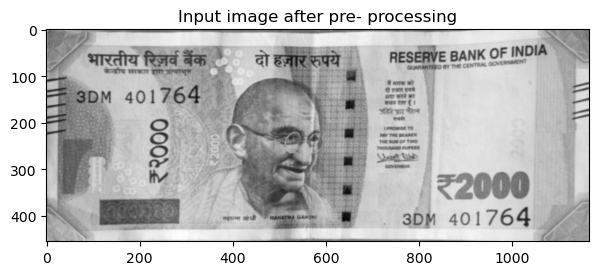

ANALYSIS OF FEATURE 1
---> Template 1 :


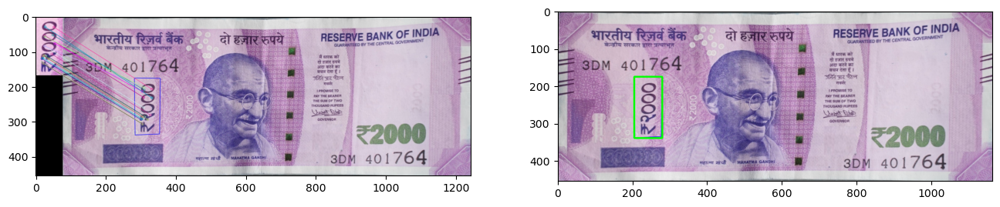

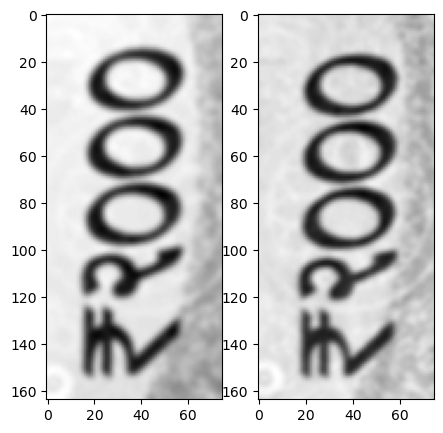

SSIM score:  0.6348914353124461 

---> Template 2 :


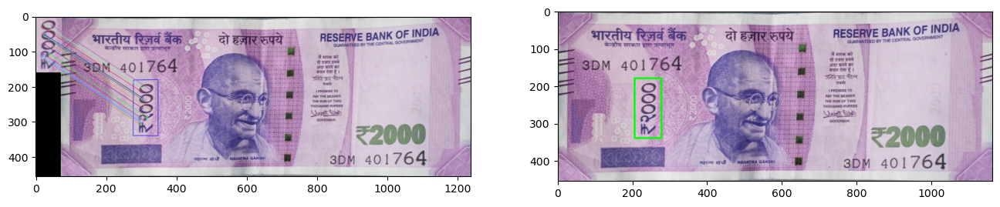

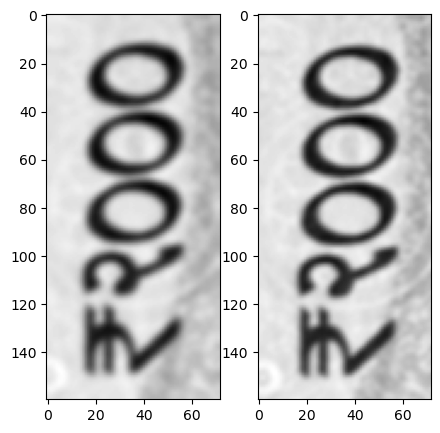

SSIM score:  0.8444759770256139 

---> Template 3 :


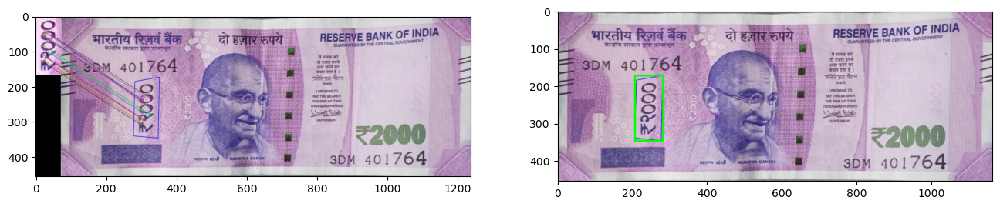

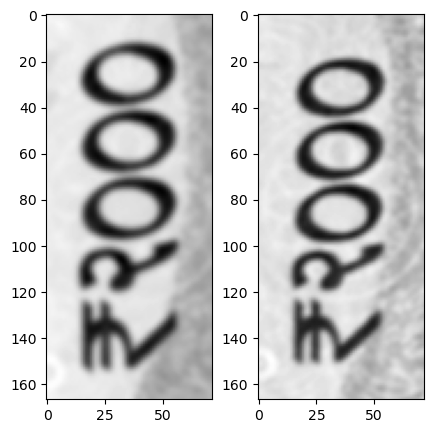

SSIM score:  0.47528920199998764 

---> Template 4 :


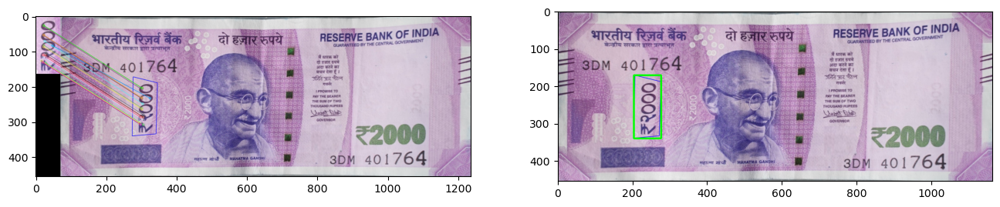

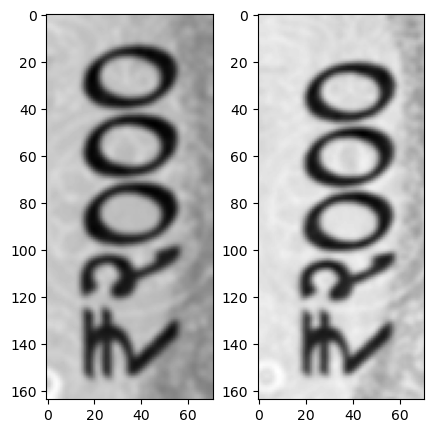

SSIM score:  0.3931613162855438 

---> Template 5 :


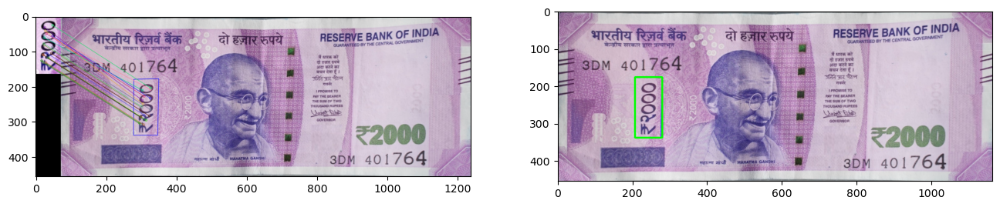

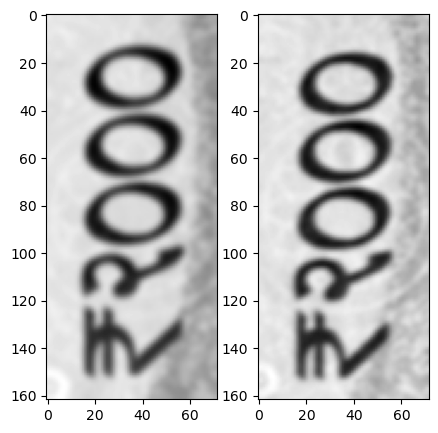

SSIM score:  0.587945572037314 

---> Template 6 :


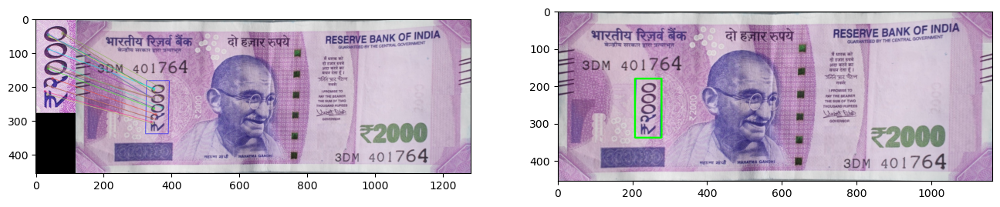

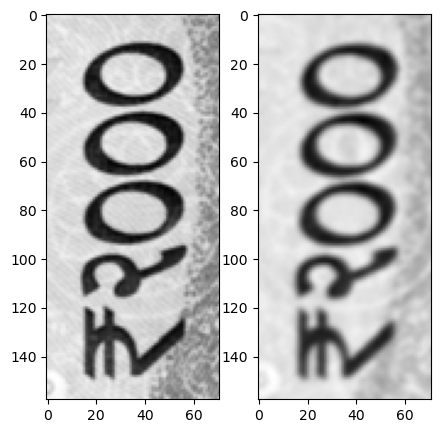

SSIM score:  0.6631069824619908 

SSIM score set of Feature 1:  [0.6348914353124461, 0.8444759770256139, 0.47528920199998764, 0.3931613162855438, 0.587945572037314, 0.6631069824619908] 

Average SSIM of Feature 1:  0.5998117475204827 

ANALYSIS OF FEATURE 2
---> Template 1 :


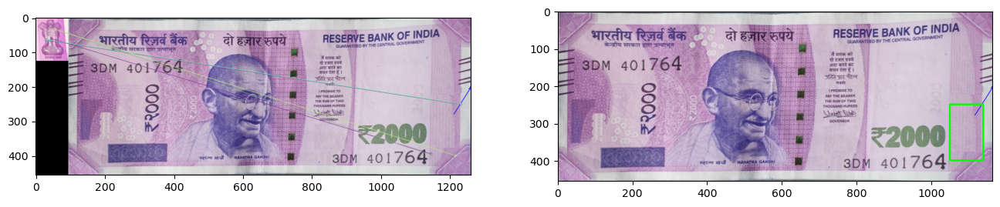

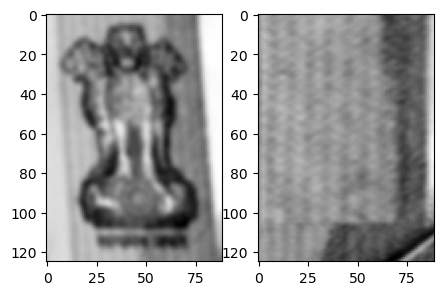

SSIM score:  0.3723835683835227 

---> Template 2 :


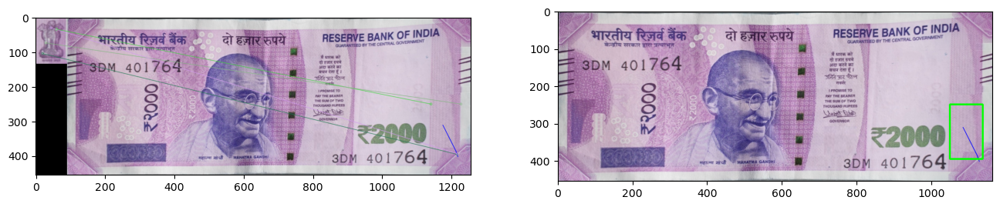

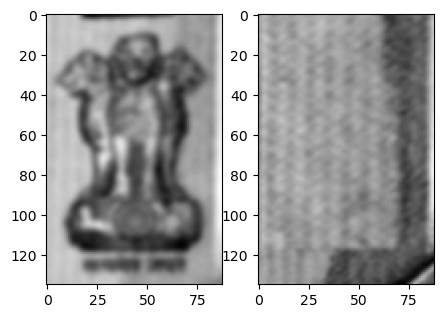

SSIM score:  0.4377479264328845 

---> Template 3 :


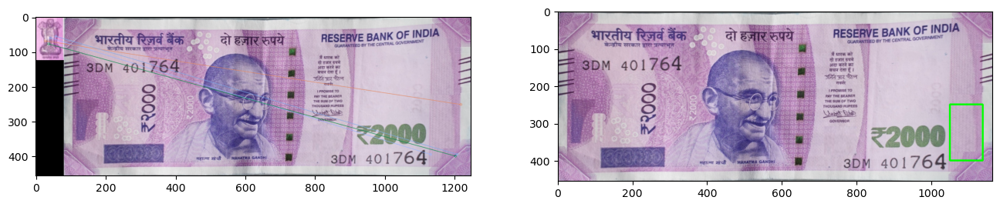

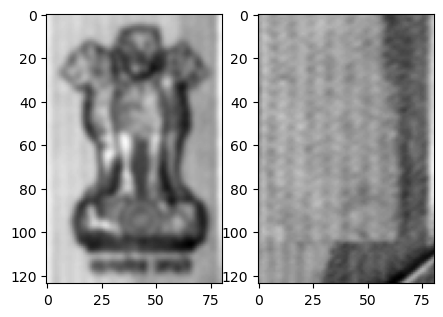

SSIM score:  0.36658531554387963 

---> Template 4 :


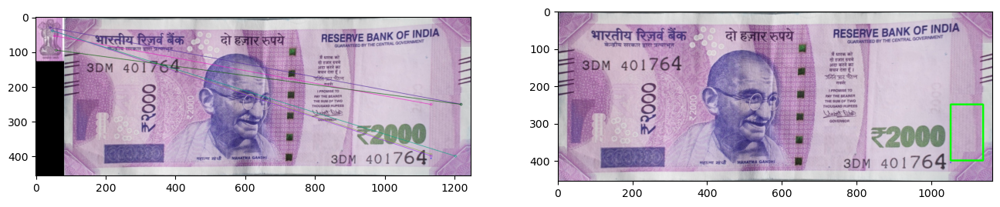

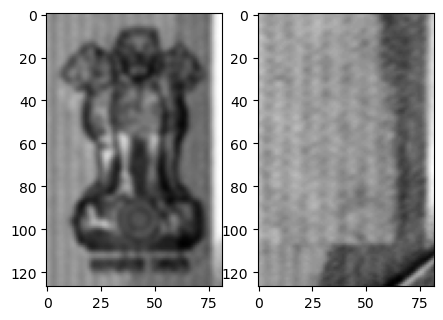

SSIM score:  0.3878745624958747 

---> Template 5 :
Not enough matches found: 3 matches.
An Error occurred - Homography matrix is of NoneType
---> Template 6 :


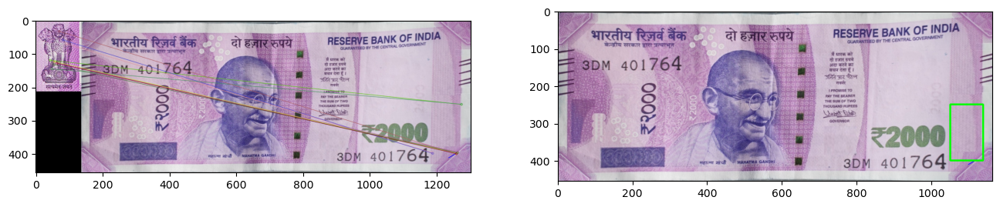

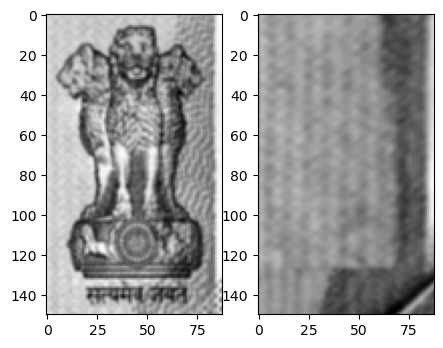

SSIM score:  0.23393149637941255 

SSIM score set of Feature 2:  [0.3723835683835227, 0.4377479264328845, 0.36658531554387963, 0.3878745624958747, 0.23393149637941255] 

Average SSIM of Feature 2:  0.35970457384711485 

ANALYSIS OF FEATURE 3
---> Template 1 :


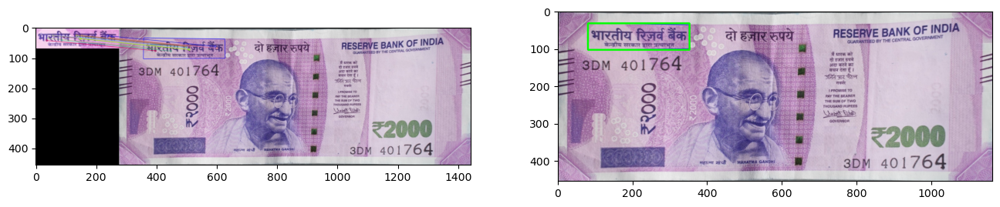

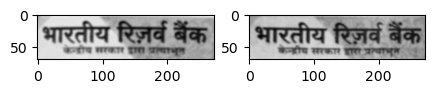

SSIM score:  0.37491090507276015 

---> Template 2 :


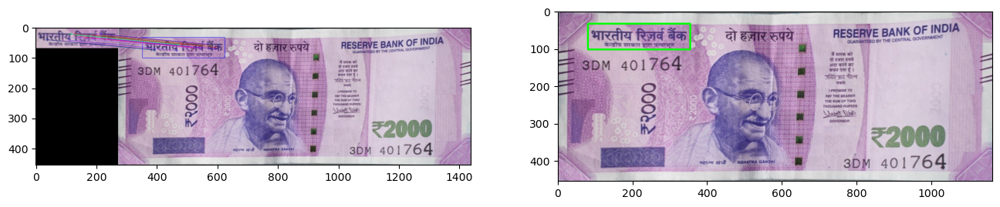

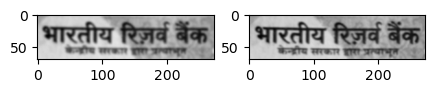

SSIM score:  0.9308507289405512 

---> Template 3 :


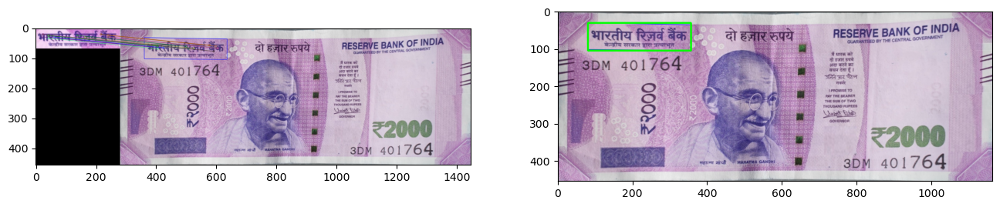

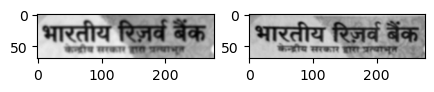

SSIM score:  0.5455151890730519 

---> Template 4 :


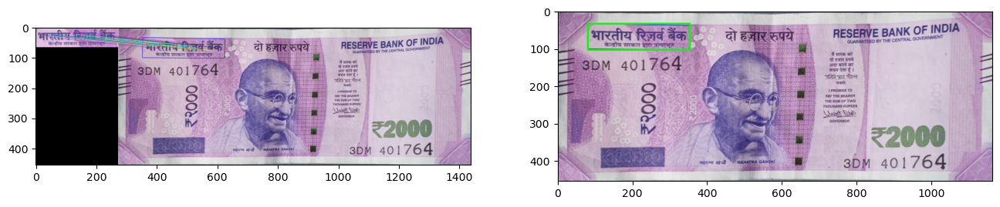

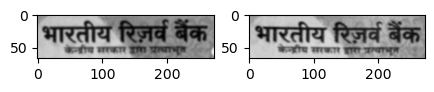

SSIM score:  0.48257708761041834 

---> Template 5 :


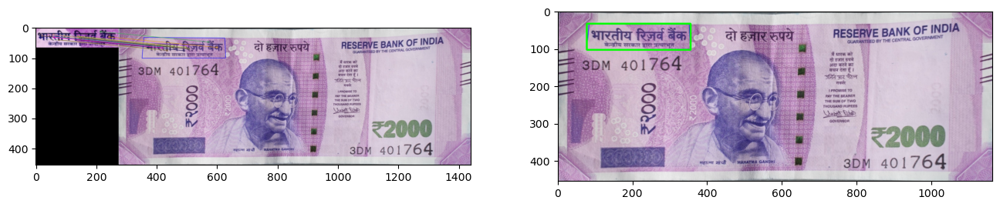

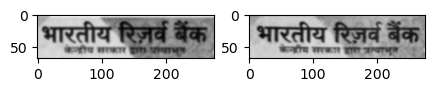

SSIM score:  0.41116888647931393 

---> Template 6 :


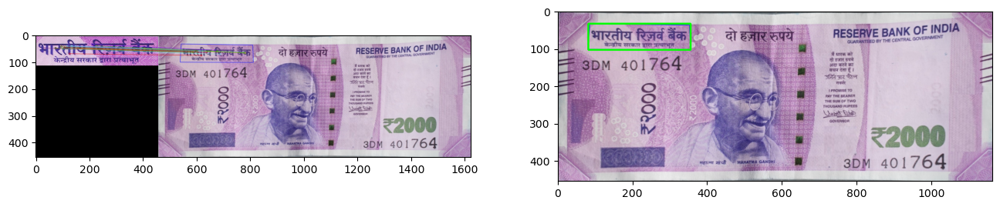

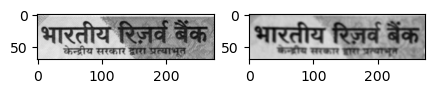

SSIM score:  0.43526978706967423 

SSIM score set of Feature 3:  [0.37491090507276015, 0.9308507289405512, 0.5455151890730519, 0.48257708761041834, 0.41116888647931393, 0.43526978706967423] 

Average SSIM of Feature 3:  0.5300487640409616 

ANALYSIS OF FEATURE 4
---> Template 1 :
Template Discarded- Area of extracted feature is outside permitted range!
---> Template 2 :


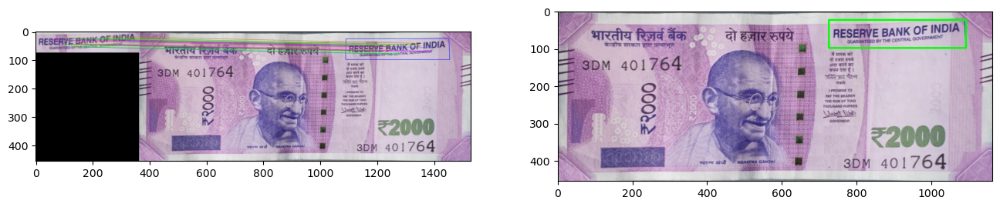

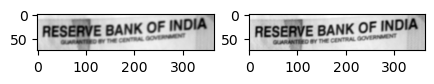

SSIM score:  0.9132433221743086 

---> Template 3 :
Template Discarded- Area of extracted feature is outside permitted range!
---> Template 4 :


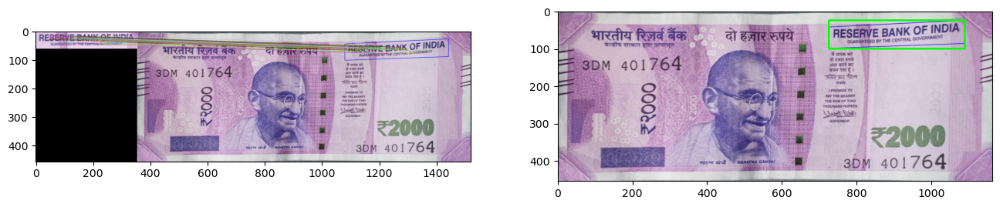

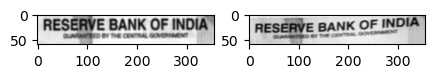

SSIM score:  0.2856339774094668 

---> Template 5 :
Template Discarded- Area of extracted feature is outside permitted range!
---> Template 6 :


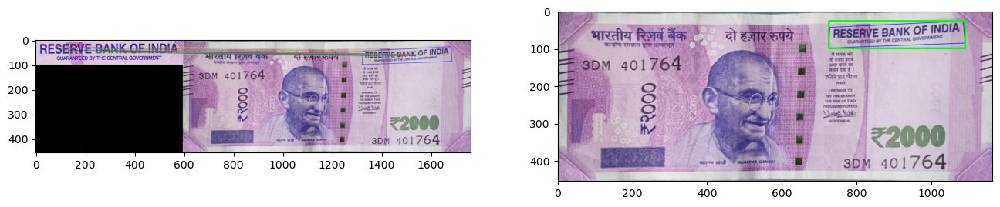

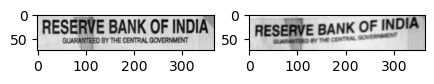

SSIM score:  0.22073994713728487 

SSIM score set of Feature 4:  [0.9132433221743086, 0.2856339774094668, 0.22073994713728487] 

Average SSIM of Feature 4:  0.47320574890702005 

ANALYSIS OF FEATURE 5
---> Template 1 :
Template Discarded- Area of extracted feature is outside permitted range!
---> Template 2 :


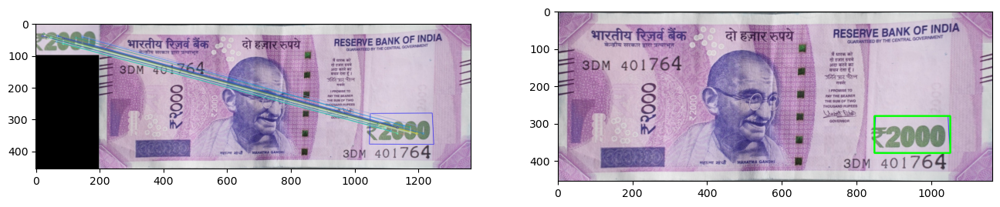

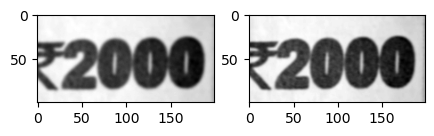

SSIM score:  0.9410464931906263 

---> Template 3 :


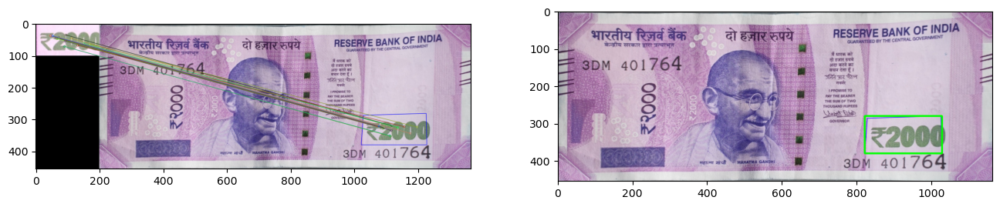

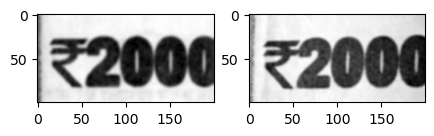

SSIM score:  0.8285660877379742 

---> Template 4 :
Template Discarded- Area of extracted feature is outside permitted range!
---> Template 5 :
Template Discarded- Area of extracted feature is outside permitted range!
---> Template 6 :


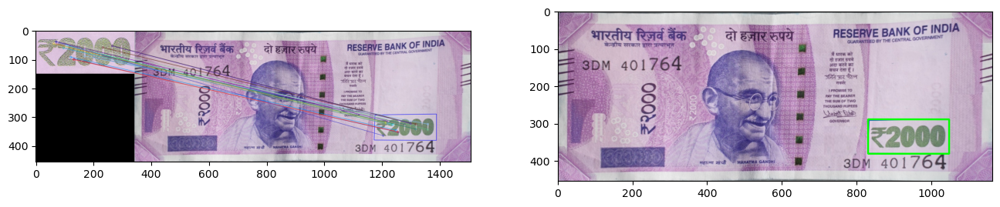

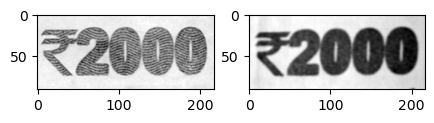

SSIM score:  0.6043706038190617 

SSIM score set of Feature 5:  [0.9410464931906263, 0.8285660877379742, 0.6043706038190617] 

Average SSIM of Feature 5:  0.7913277282492208 

ANALYSIS OF FEATURE 6
---> Template 1 :
Template Discarded- Area of extracted feature is outside permitted range!
---> Template 2 :


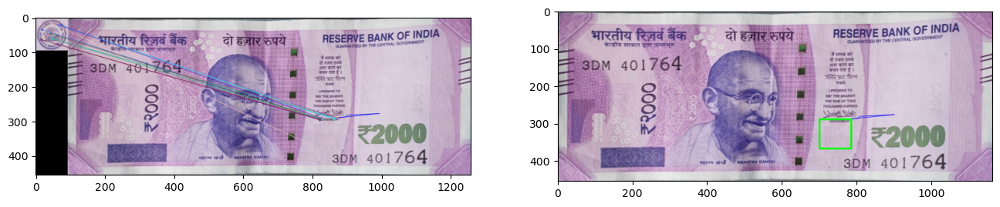

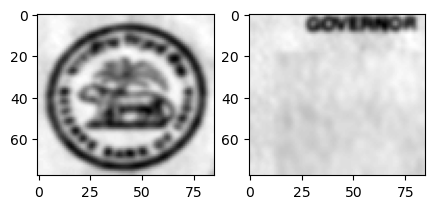

SSIM score:  0.2539938625588656 

---> Template 3 :


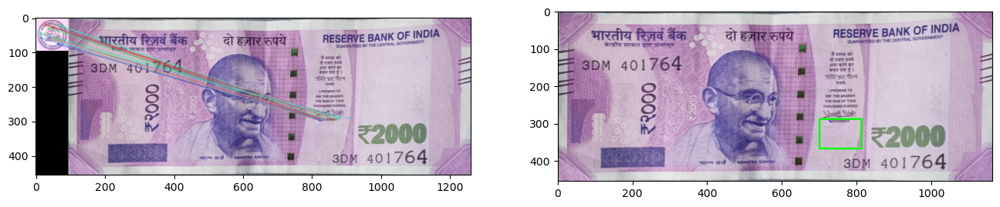

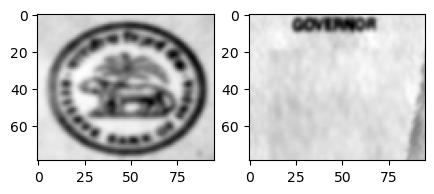

SSIM score:  0.23208193071227684 

---> Template 4 :


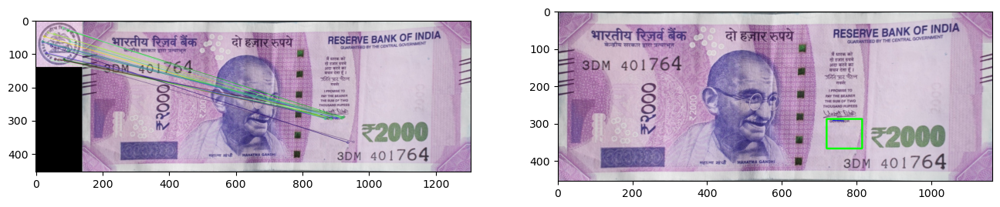

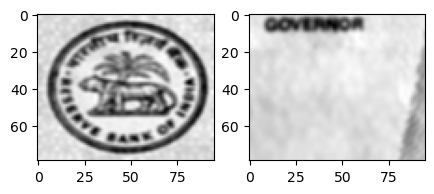

SSIM score:  0.18048610652731992 

---> Template 5 :


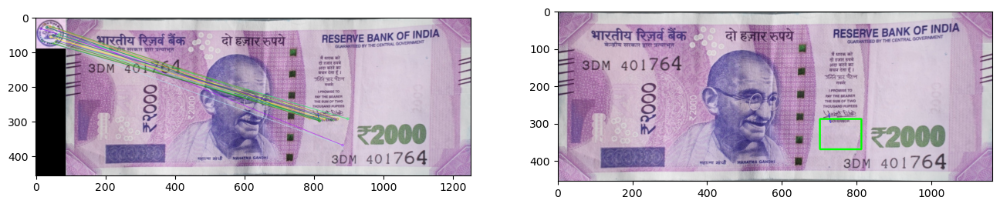

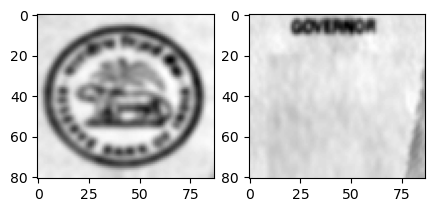

SSIM score:  0.1993879710694808 

---> Template 6 :
Template Discarded- Area of extracted feature is outside permitted range!
SSIM score set of Feature 6:  [0.2539938625588656, 0.23208193071227684, 0.18048610652731992, 0.1993879710694808] 

Average SSIM of Feature 6:  0.2164874677169858 

ANALYSIS OF FEATURE 7
---> Template 1 :


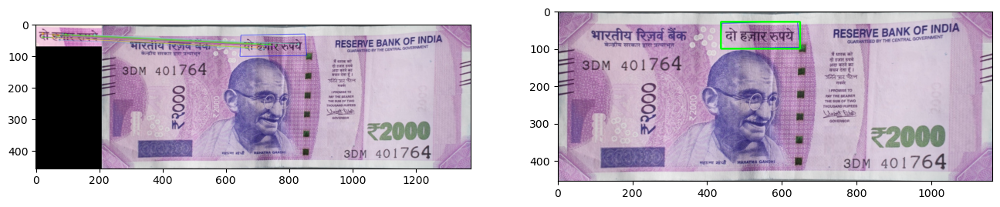

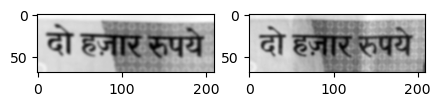

SSIM score:  0.5384288942194223 

---> Template 2 :


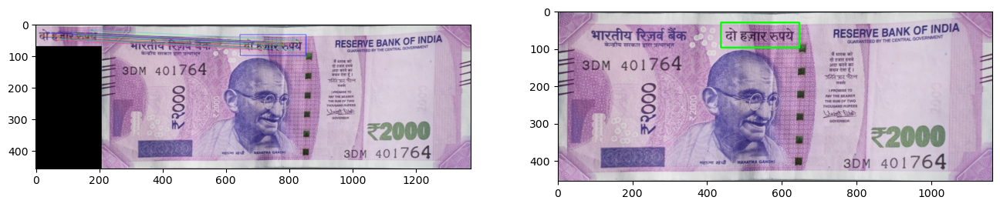

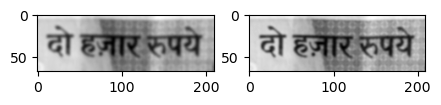

SSIM score:  0.926994016039185 

---> Template 3 :


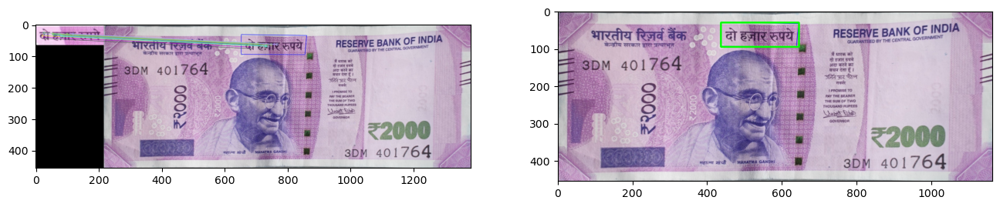

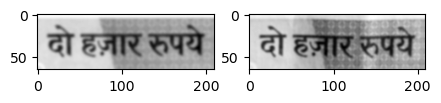

SSIM score:  0.6686953255214699 

---> Template 4 :


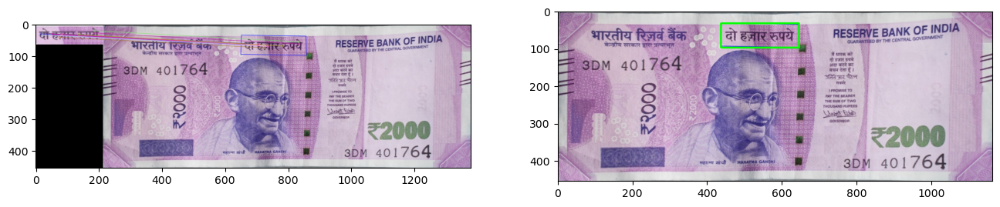

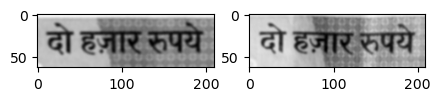

SSIM score:  0.6733284129143727 

---> Template 5 :


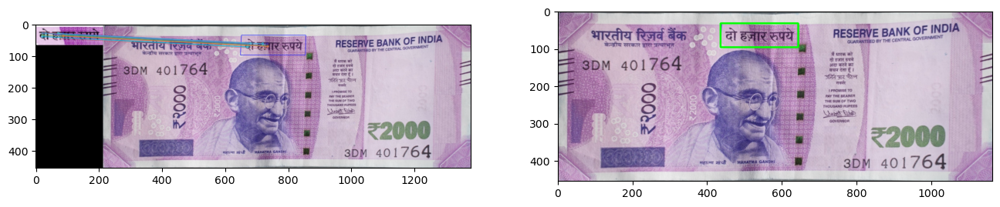

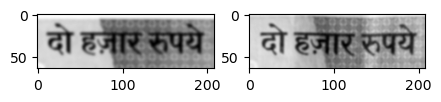

SSIM score:  0.6297398253826009 

---> Template 6 :


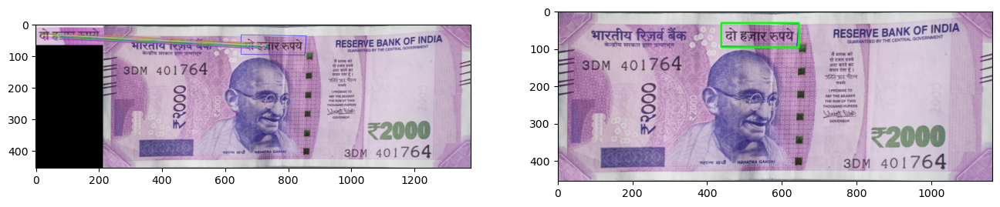

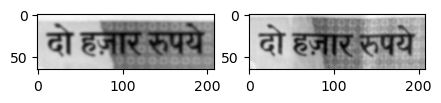

SSIM score:  0.5370048060682461 

SSIM score set of Feature 7:  [0.5384288942194223, 0.926994016039185, 0.6686953255214699, 0.6733284129143727, 0.6297398253826009, 0.5370048060682461] 

Average SSIM of Feature 7:  0.6623652133575494 

Final Score- set list: 

Feature 1 : [0.6348914353124461, 0.8444759770256139, 0.47528920199998764, 0.3931613162855438, 0.587945572037314, 0.6631069824619908]
Feature 2 : [0.3723835683835227, 0.4377479264328845, 0.36658531554387963, 0.3878745624958747, 0.23393149637941255]
Feature 3 : [0.37491090507276015, 0.9308507289405512, 0.5455151890730519, 0.48257708761041834, 0.41116888647931393, 0.43526978706967423]
Feature 4 : [0.9132433221743086, 0.2856339774094668, 0.22073994713728487]
Feature 5 : [0.9410464931906263, 0.8285660877379742, 0.6043706038190617]
Feature 6 : [0.2539938625588656, 0.23208193071227684, 0.18048610652731992, 0.1993879710694808]
Feature 7 : [0.5384288942194223, 0.926994016039185, 0.6686953255214699, 0.6733284129143727, 0.6297398253826009, 0

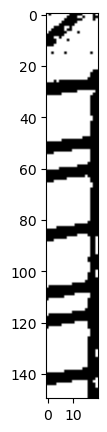

Number of black regions found in each column: 
8
8
9
9
8
8
8
10 Erroneous -> discarded
10 Erroneous -> discarded
7
7
7
9
8
8
7
8
5
3
6

Number of columns examined:  20
Number of non- erroneous columns found:  18

Average number of black regions is:  7.388888888888889

ANALYSIS OF FEATURE 9 : RIGHT BLEED LINES



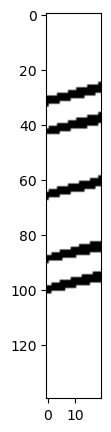

Number of black regions found in each column: 
5
5
5
5
5
5
5
5
5
5
5
5
5
5
5
5
5
5
5
5

Number of columns examined:  20
Number of non- erroneous columns found:  20

Average number of black regions is:  5.0


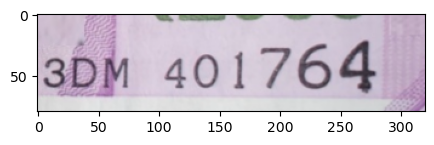



ANALYSIS OF FEATURE 10 : NUMBER PANEL 

---> Threshold 1 with Threshold value 90 :
Unsuccessful!
---> Threshold 2 with Threshold value 95 :
Unsuccessful!
---> Threshold 3 with Threshold value 100 :
Unsuccessful!
---> Threshold 4 with Threshold value 105 :
Unsuccessful!
---> Threshold 5 with Threshold value 110 :
Unsuccessful!
---> Threshold 6 with Threshold value 115 :
Unsuccessful!
---> Threshold 7 with Threshold value 120 :
Unsuccessful!
---> Threshold 8 with Threshold value 125 :
Test Successful: 9 letters found!
---> Threshold 9 with Threshold value 130 :
Test Successful: 9 letters found!
---> Threshold 10 with Threshold value 135 :
Test Successful: 9 letters found!
Test Passed!- 9 characters were detected in the serial number panel.


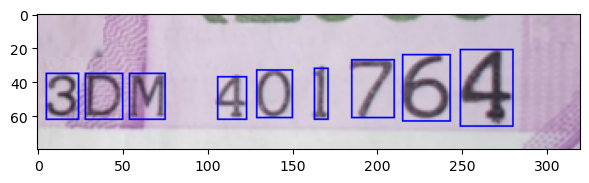



RESULT ANALYSIS

Feature 1: Successful
Feature 2: Unsuccessful
Feature 3: Successful
Feature 4: Successful
Feature 5: Successful
Feature 6: Unsuccessful
Feature 7: Successful
Feature 8: Successful- 7 bleed lines found in left part of currency note
Feature 9: Unsuccessful!
Feature 10: Successful- 9 characters found in number panel of currency note

Result Summary:
7 out of 10 features are VERIFIED!


In [53]:
Testing()